<a href="https://colab.research.google.com/github/neehasajja/waymo-opendataset/blob/main/hkp.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
import pyarrow.parquet as pq
import pandas as pd

# Set the path to the Parquet file
parquet_file_path = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'

# Read the Parquet file into a Pyarrow table
table = pq.read_table(parquet_file_path)

# Convert the table to a Pandas DataFrame
df = table.to_pandas()

# Print the first 10 rows of the DataFrame
print(df.head(10))
print(df.columns)

                                                               key.segment_context_name  \
index                                                                                     
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   
30779396576054160_1880_000_1900_000;15578450726...  30779396576054160_1880_000_1900_000   

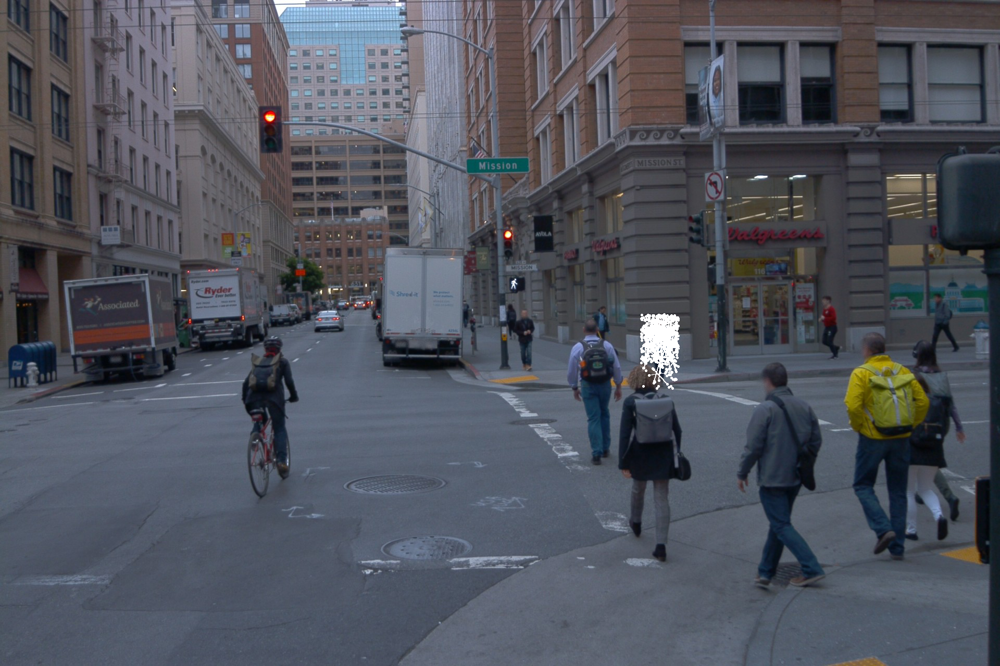

In [3]:
import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

# Load the camera_box_data (bounding boxes)
camera_box_file = '/content/drive/MyDrive/validation/camera_box/file1.parquet'
camera_box_data = pd.read_parquet(camera_box_file)

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = '1b660186-6119-45b5-8d6b-541b9a72c812'

# Filter the camera_box_data based on the timestamp, camera name, and object ID
object_boxes = camera_box_data[
    (camera_box_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_box_data['key.camera_name'] == camera_name) &
    (camera_box_data['key.camera_object_id'] == object_id)
]

# Create a new image with the same size
overlay_img = Image.new('RGBA', image.size, (0, 0, 0, 0))

# Create a drawing context
draw = ImageDraw.Draw(overlay_img)

# Calculate the scaling factors for the image and keypoints
image_width, image_height = image.size
x_scale = image_width / max(x)
y_scale = image_height / max(y)

# Draw keypoints on the humans within the bounding boxes
for _, row in object_boxes.iterrows():
    x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
    y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
    x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
    y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)

    # Draw keypoints on the humans within the bounding box
    for i in range(len(keypoints)):
        keypoint_x = int(keypoints[i][0] * x_scale)
        keypoint_y = int(keypoints[i][1] * y_scale)

        # Check if the keypoint is within the bounding box
        if x1 <= keypoint_x <= x2 and y1 <= keypoint_y <= y2:
            # Draw the keypoint
            draw.ellipse((keypoint_x - 2, keypoint_y - 2, keypoint_x + 2, keypoint_y + 2), fill='white')

            # Connect keypoints with lines
            if i < len(keypoints) - 1:
                next_keypoint_x = int(keypoints[i + 1][0] * x_scale)
                next_keypoint_y = int(keypoints[i + 1][1] * y_scale)

                # Check if the next keypoint is within the bounding box
                if x1 <= next_keypoint_x <= x2 and y1 <= next_keypoint_y <= y2:
                    draw.line([(keypoint_x, keypoint_y), (next_keypoint_x, next_keypoint_y)], fill='white', width=2)

# Overlay the keypoints on the image
result = Image.alpha_composite(image.convert('RGBA'), overlay_img)

# Show the resulting image
result.show()


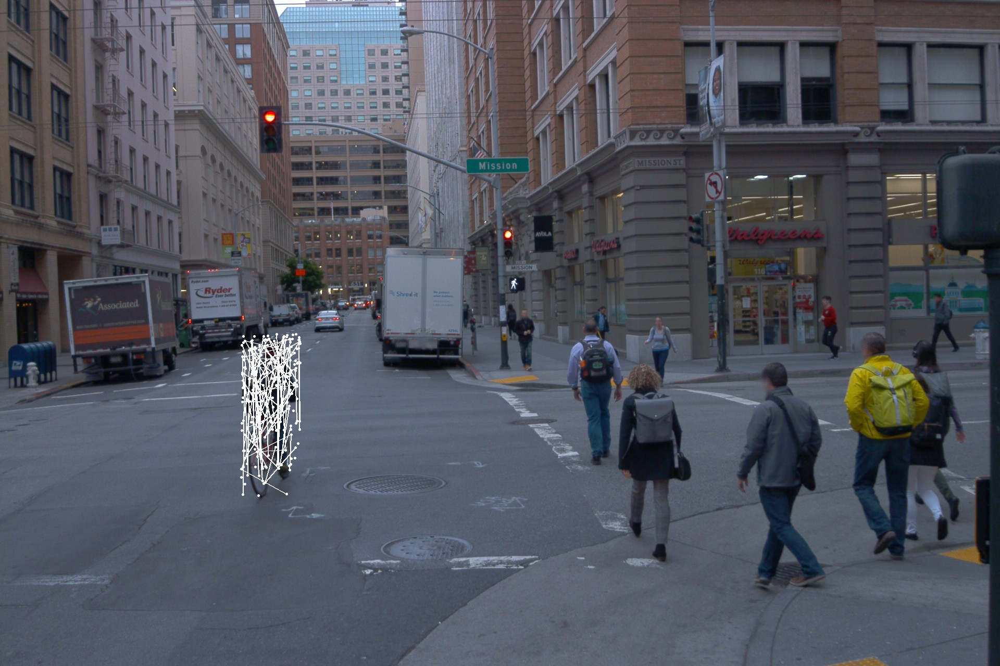

In [4]:
import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

# Load the camera_box_data (bounding boxes)
camera_box_file = '/content/drive/MyDrive/validation/camera_box/file1.parquet'
camera_box_data = pd.read_parquet(camera_box_file)

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = 'adf51950-1e7e-45c9-9d08-5aeeec1a4d96'

# Filter the camera_box_data based on the timestamp, camera name, and object ID
object_boxes = camera_box_data[
    (camera_box_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_box_data['key.camera_name'] == camera_name) &
    (camera_box_data['key.camera_object_id'] == object_id)
]

# Create a new image with the same size
overlay_img = Image.new('RGBA', image.size, (0, 0, 0, 0))

# Create a drawing context
draw = ImageDraw.Draw(overlay_img)

# Calculate the scaling factors for the image and keypoints
image_width, image_height = image.size
x_scale = image_width / max(x)
y_scale = image_height / max(y)

# Draw keypoints on the humans within the bounding boxes
for _, row in object_boxes.iterrows():
    x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
    y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
    x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
    y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)

    # Draw keypoints on the humans within the bounding box
    for i in range(len(keypoints)):
        keypoint_x = int(keypoints[i][0] * x_scale)
        keypoint_y = int(keypoints[i][1] * y_scale)

        # Check if the keypoint is within the bounding box
        if x1 <= keypoint_x <= x2 and y1 <= keypoint_y <= y2:
            # Draw the keypoint
            draw.ellipse((keypoint_x - 2, keypoint_y - 2, keypoint_x + 2, keypoint_y + 2), fill='white')

            # Connect keypoints with lines
            if i < len(keypoints) - 1:
                next_keypoint_x = int(keypoints[i + 1][0] * x_scale)
                next_keypoint_y = int(keypoints[i + 1][1] * y_scale)

                # Check if the next keypoint is within the bounding box
                if x1 <= next_keypoint_x <= x2 and y1 <= next_keypoint_y <= y2:
                    draw.line([(keypoint_x, keypoint_y), (next_keypoint_x, next_keypoint_y)], fill='white', width=2)

# Overlay the keypoints on the image
result = Image.alpha_composite(image.convert('RGBA'), overlay_img)

# Show the resulting image
result.show()


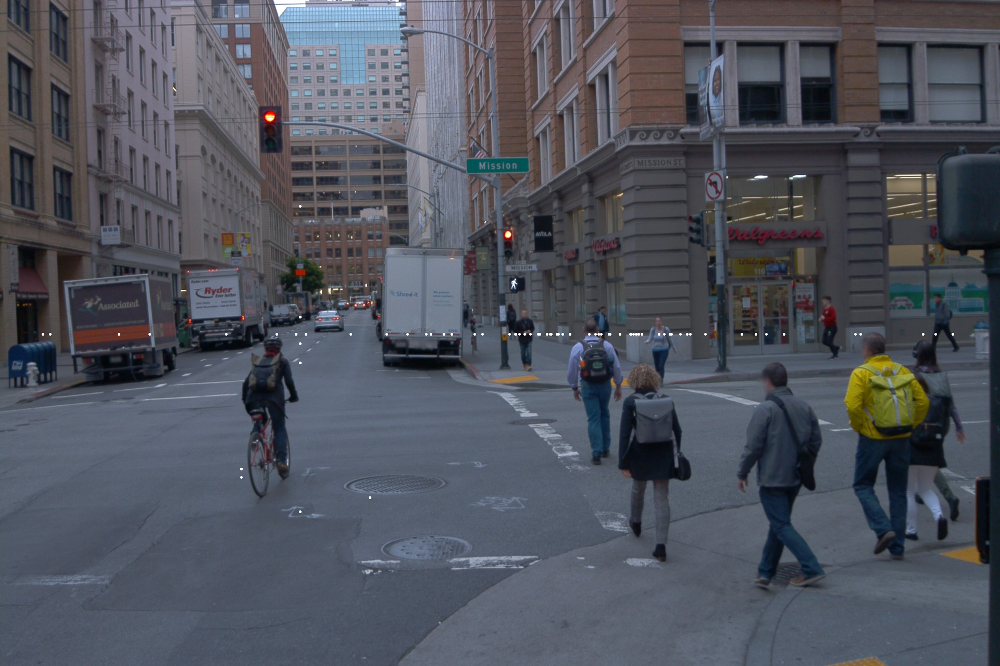

In [5]:
import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

# Load the camera_box_data (bounding boxes)
camera_box_file = '/content/drive/MyDrive/validation/camera_box/file1.parquet'
camera_box_data = pd.read_parquet(camera_box_file)

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = 'adf51950-1e7e-45c9-9d08-5aeeec1a4d96'

# Filter the camera_box_data based on the timestamp, camera name, and object ID
object_boxes = camera_box_data[
    (camera_box_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_box_data['key.camera_name'] == camera_name) &
    (camera_box_data['key.camera_object_id'] == object_id)
]

# Create a new image with the same size
overlay_img = Image.new('RGBA', image.size, (0, 0, 0, 0))

# Create a drawing context
draw = ImageDraw.Draw(overlay_img)

# Calculate the scaling factors for the image and keypoints
image_width, image_height = image.size
x_scale = image_width / max(x)
y_scale = image_height / max(y)

# Draw keypoints on the humans within the bounding boxes
for _, row in object_boxes.iterrows():
    x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
    y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
    x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
    y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)

    # Draw keypoints on the humans within the bounding box
    for i in range(len(keypoints)):
        keypoint_x = int(keypoints[i][0] * x_scale)
        keypoint_y = int(keypoints[i][1] * y_scale)

        # Check if the keypoint is on the edge of the object
        if (
            (keypoint_x == x1 or keypoint_x == x2) or
            (keypoint_y == y1 or keypoint_y == y2)
        ):
            # Draw the keypoint
            draw.ellipse((keypoint_x - 2, keypoint_y - 2, keypoint_x + 2, keypoint_y + 2), fill='white')

# Overlay the keypoints on the image
result = Image.alpha_composite(image.convert('RGBA'), overlay_img)

# Show the resulting image
result.show()

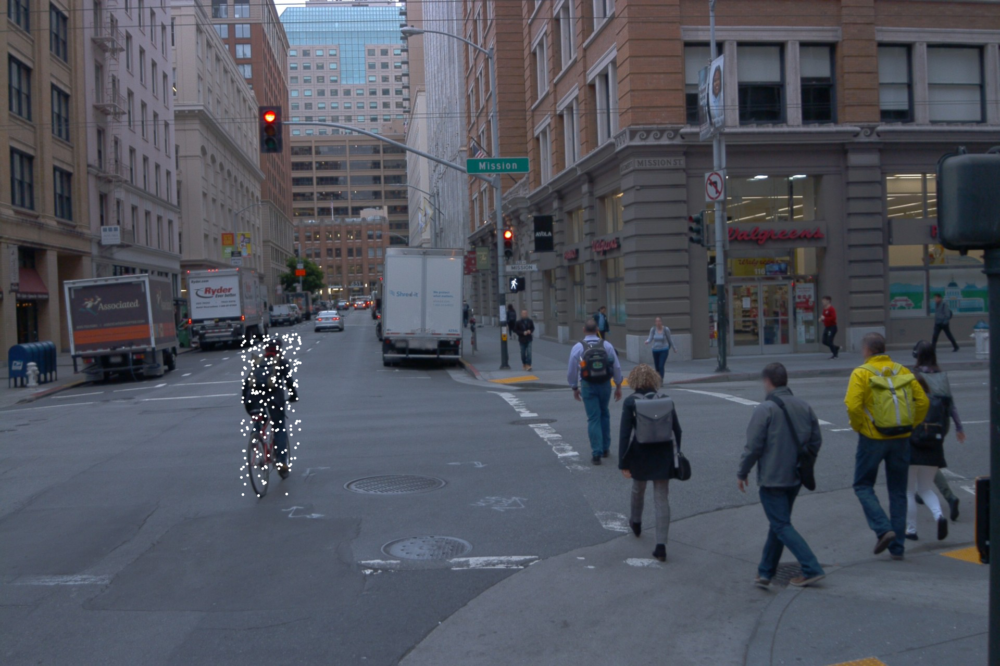

In [7]:

import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

# Load the camera_box_data (bounding boxes)
camera_box_file = '/content/drive/MyDrive/validation/camera_box/file1.parquet'
camera_box_data = pd.read_parquet(camera_box_file)

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = 'adf51950-1e7e-45c9-9d08-5aeeec1a4d96'

# Filter the camera_box_data based on the timestamp, camera name, and object ID
object_boxes = camera_box_data[
    (camera_box_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_box_data['key.camera_name'] == camera_name) &
    (camera_box_data['key.camera_object_id'] == object_id)
]

# Create a new image with the same size
overlay_img = Image.new('RGBA', image.size, (0, 0, 0, 0))

# Create a drawing context
draw = ImageDraw.Draw(overlay_img)

# Calculate the scaling factors for the image and keypoints
image_width, image_height = image.size
x_scale = image_width / max(x)
y_scale = image_height / max(y)

# Draw keypoints on the object
for _, row in object_boxes.iterrows():
    x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
    y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
    x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
    y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)

    # Draw keypoints on the object
    for i in range(len(keypoints)):
        keypoint_x = int(keypoints[i][0] * x_scale)
        keypoint_y = int(keypoints[i][1] * y_scale)

        # Check if the keypoint is within the bounding box
        if x1 <= keypoint_x <= x2 and y1 <= keypoint_y <= y2:
            # Draw the keypoint
            draw.ellipse((keypoint_x - 2, keypoint_y - 2, keypoint_x + 2, keypoint_y + 2), fill='white')

# Overlay the keypoints on the image
result = Image.alpha_composite(image.convert('RGBA'), overlay_img)

# Show the resulting image
result.show()


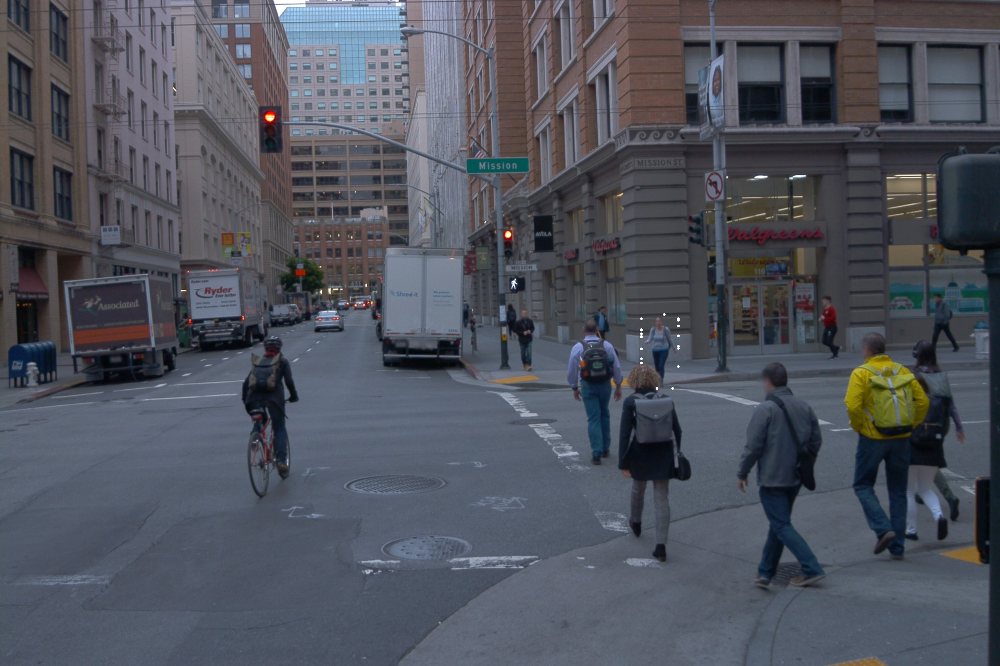

In [10]:
import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

# Load the camera_box_data (bounding boxes)
camera_box_file = '/content/drive/MyDrive/validation/camera_box/file1.parquet'
camera_box_data = pd.read_parquet(camera_box_file)

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = '1b660186-6119-45b5-8d6b-541b9a72c812'

# Filter the camera_box_data based on the timestamp, camera name, and object ID
object_boxes = camera_box_data[
    (camera_box_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_box_data['key.camera_name'] == camera_name) &
    (camera_box_data['key.camera_object_id'] == object_id)
]

# Create a new image with the same size
overlay_img = Image.new('RGBA', image.size, (0, 0, 0, 0))

# Create a drawing context
draw = ImageDraw.Draw(overlay_img)

# Calculate the scaling factors for the image and keypoints
image_width, image_height = image.size
x_scale = image_width / max(x)
y_scale = image_height / max(y)

# Draw keypoints on the object
for _, row in object_boxes.iterrows():
    x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
    y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
    x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
    y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)

    # Draw keypoints on the object
    for i in range(len(keypoints)):
        keypoint_x = int(keypoints[i][0] * x_scale)
        keypoint_y = int(keypoints[i][1] * y_scale)

        # Check if the keypoint is on the edge of the bounding box
        if (
            (keypoint_x == x1 or keypoint_x == x2) and y1 <= keypoint_y <= y2
        ) or (
            (keypoint_y == y1 or keypoint_y == y2) and x1 <= keypoint_x <= x2
        ):
            # Draw the keypoint
            draw.ellipse((keypoint_x - 2, keypoint_y - 2, keypoint_x + 2, keypoint_y + 2), fill='white')

# Overlay the keypoints on the image
result = Image.alpha_composite(image.convert('RGBA'), overlay_img)

# Show the resulting image
result.show()

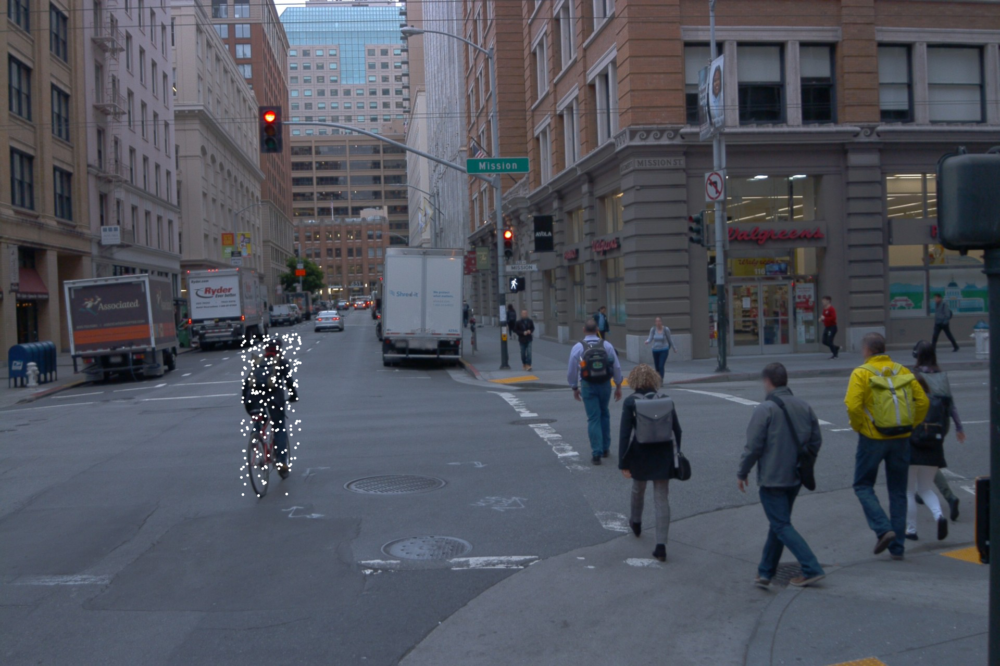

In [11]:
import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

# Load the camera_box_data (bounding boxes)
camera_box_file = '/content/drive/MyDrive/validation/camera_box/file1.parquet'
camera_box_data = pd.read_parquet(camera_box_file)

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = 'adf51950-1e7e-45c9-9d08-5aeeec1a4d96'

# Filter the camera_box_data based on the timestamp, camera name, and object ID
object_boxes = camera_box_data[
    (camera_box_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_box_data['key.camera_name'] == camera_name) &
    (camera_box_data['key.camera_object_id'] == object_id)
]

# Create a new image with the same size
overlay_img = Image.new('RGBA', image.size, (0, 0, 0, 0))

# Create a drawing context
draw = ImageDraw.Draw(overlay_img)

# Calculate the scaling factors for the image and keypoints
image_width, image_height = image.size
x_scale = image_width / max(x)
y_scale = image_height / max(y)

# Draw keypoints on the object
for _, row in object_boxes.iterrows():
    x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
    y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
    x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
    y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)

    # Draw keypoints on the object
    for i in range(len(keypoints)):
        keypoint_x = int(keypoints[i][0] * x_scale)
        keypoint_y = int(keypoints[i][1] * y_scale)

        # Check if the keypoint is within the bounding box
        if x1 <= keypoint_x <= x2 and y1 <= keypoint_y <= y2:
            # Draw the keypoint
            draw.ellipse((keypoint_x - 2, keypoint_y - 2, keypoint_x + 2, keypoint_y + 2), fill='white')

# Overlay the keypoints on the image
result = Image.alpha_composite(image.convert('RGBA'), overlay_img)

# Show the resulting image
result.show()

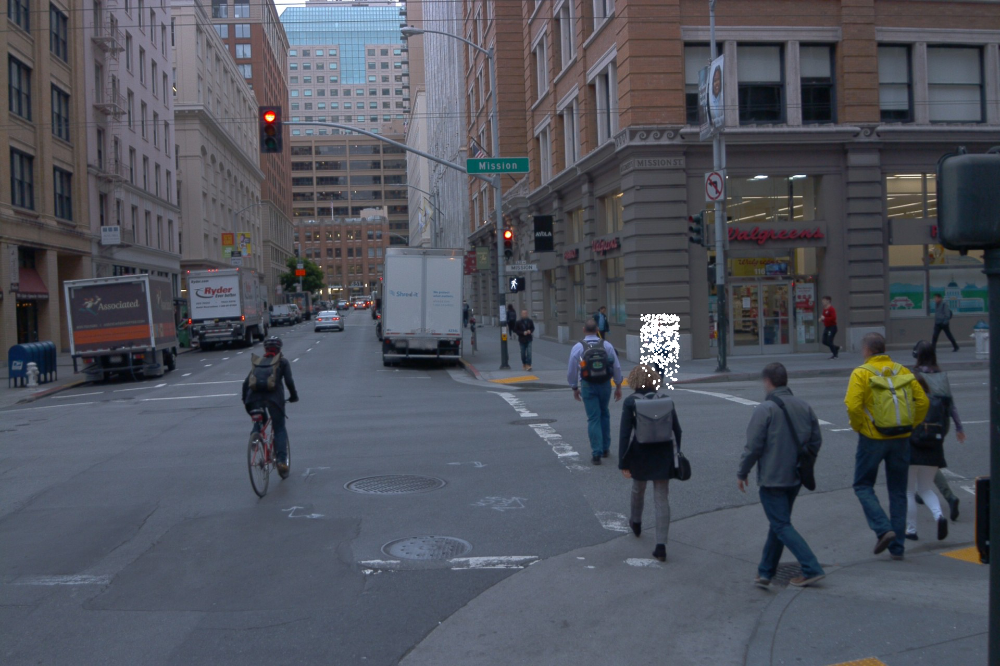

In [14]:
import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

# Load the camera_box_data (bounding boxes)
camera_box_file = '/content/drive/MyDrive/validation/camera_box/file1.parquet'
camera_box_data = pd.read_parquet(camera_box_file)

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = '1b660186-6119-45b5-8d6b-541b9a72c812'

# Filter the camera_box_data based on the timestamp, camera name, and object ID
object_boxes = camera_box_data[
    (camera_box_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_box_data['key.camera_name'] == camera_name) &
    (camera_box_data['key.camera_object_id'] == object_id)
]

# Create a new image with the same size
overlay_img = Image.new('RGBA', image.size, (0, 0, 0, 0))

# Create a drawing context
draw = ImageDraw.Draw(overlay_img)

# Calculate the scaling factors for the image and keypoints
image_width, image_height = image.size
x_scale = image_width / max(x)
y_scale = image_height / max(y)

# Draw keypoints on the object
for _, row in object_boxes.iterrows():
    x1 = int(row['[CameraBoxComponent].box.center.x'] - row['[CameraBoxComponent].box.size.x'] / 2)
    y1 = int(row['[CameraBoxComponent].box.center.y'] - row['[CameraBoxComponent].box.size.y'] / 2)
    x2 = int(row['[CameraBoxComponent].box.center.x'] + row['[CameraBoxComponent].box.size.x'] / 2)
    y2 = int(row['[CameraBoxComponent].box.center.y'] + row['[CameraBoxComponent].box.size.y'] / 2)

    # Draw keypoints on the object
    for i in range(len(keypoints)):
        keypoint_x = int(keypoints[i][0] * x_scale)
        keypoint_y = int(keypoints[i][1] * y_scale)

        # Check if the keypoint is within the bounding box
        if x1 <= keypoint_x <= x2 and y1 <= keypoint_y <= y2:
            # Draw the keypoint
            draw.ellipse((keypoint_x - 2, keypoint_y - 2, keypoint_x + 2, keypoint_y + 2), fill='white')

# Overlay the keypoints on the image
result = Image.alpha_composite(image.convert('RGBA'), overlay_img)

# Show the resulting image
result.show()

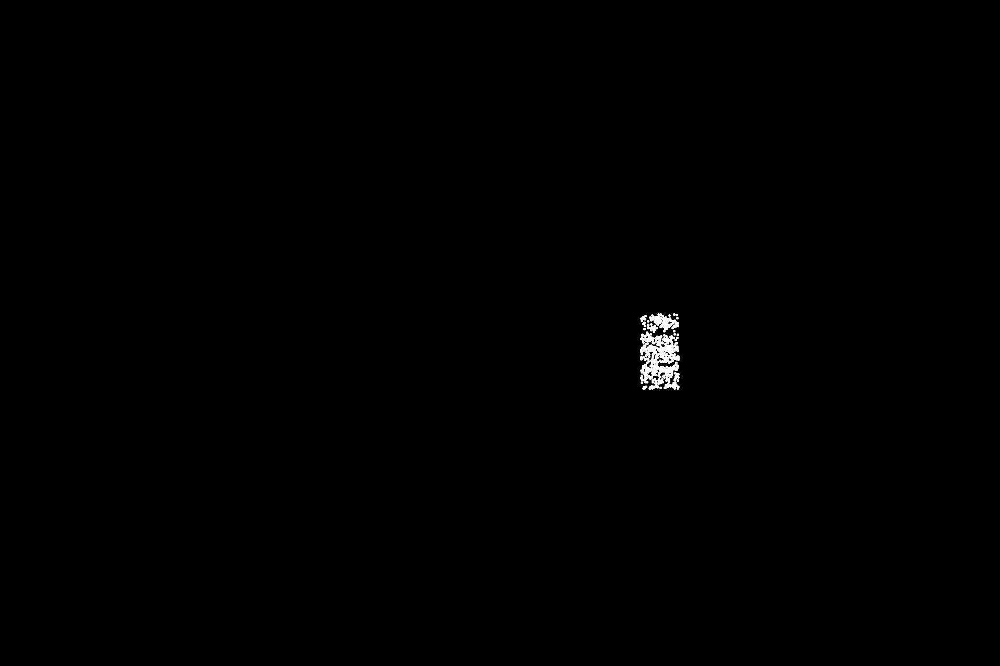

In [33]:
import cv2
import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

#
# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = '1b660186-6119-45b5-8d6b-541b9a72c812'

# Filter the camera_box_data based on the timestamp, camera name, and object ID
object_boxes = camera_box_data[
    (camera_box_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_box_data['key.camera_name'] == camera_name) &
    (camera_box_data['key.camera_object_id'] == object_id)
]


# Create a blank image with the same size
blank_image = Image.new('RGB', image.size)

# Create a drawing context
draw = ImageDraw.Draw(blank_image)

# Draw keypoints on the blank image
for i in range(len(keypoints)):
    keypoint_x = int(keypoints[i][0])
    keypoint_y = int(keypoints[i][1])

    # Check if the keypoint is within the bounding box
    if x1 <= keypoint_x <= x2 and y1 <= keypoint_y <= y2:
        # Draw the keypoint
        draw.ellipse((keypoint_x - 2, keypoint_y - 2, keypoint_x + 2, keypoint_y + 2), fill='white')

# Overlay the keypoints on the original image
result = Image.alpha_composite(image.convert('RGBA'), blank_image.convert('RGBA'))

# Show the resulting image
result.show()

In [54]:
import cv2
import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

#
# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = '1b660186-6119-45b5-8d6b-541b9a72c812'

# Filter the camera_hkp_data based on the timestamp, camera name, and object ID
filtered_keypoints = camera_hkp_data[
    (camera_hkp_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_hkp_data['key.camera_name'] == camera_name) &
    (camera_hkp_data['key.camera_object_id'] == object_id)
]['[CameraHumanKeypointsComponent].camera_keypoints[*]']

# Check if keypoints are present
if len(filtered_keypoints) == 0:
    raise ValueError("No human keypoints found in the data")

# Extract the x and y coordinates of the keypoints
x = filtered_keypoints['keypoint_2d.location_px.x'].explode().values
y = filtered_keypoints['keypoint_2d.location_px.y'].explode().values

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

# Create a blank image with the same size
blank_image = Image.new('RGB', image.size)

# Create a drawing context
draw = ImageDraw.Draw(blank_image)

# Draw keypoints on the blank image
for i in range(len(keypoints)):
    keypoint_x = int(keypoints[i][0])
    keypoint_y = int(keypoints[i][1])

    # Draw the keypoint
    draw.ellipse((keypoint_x - 2, keypoint_y - 2, keypoint_x + 2, keypoint_y + 2), fill='white')

# Overlay the keypoints on the original image
result = Image.alpha_composite(image.convert('RGBA'), blank_image.convert('RGBA'))

# Show the resulting image
result.show()


KeyError: ignored

In [50]:
import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = '1b660186-6119-45b5-8d6b-541b9a72c812'

# Filter the camera_box_data based on the timestamp, camera name, and object ID
object_boxes = camera_box_data[
    (camera_box_data['key.frame_timestamp_micros'] == timestamp) &
    (camera_box_data['key.camera_name'] == camera_name) &
    (camera_box_data['key.camera_object_id'] == object_id)
]

# Retrieve the bounding box coordinates
x1 = object_boxes['[Box2D].x1'].values[0]
y1 = object_boxes['[Box2D].y1'].values[0]
x2 = object_boxes['[Box2D].x2'].values[0]
y2 = object_boxes['[Box2D].y2'].values[0]

# Create a blank image with the same size
blank_image = Image.new('RGB', image.size)

# Create a drawing context
draw = ImageDraw.Draw(blank_image)

# Draw keypoints on the blank image within the bounding box
for i in range(len(keypoints)):
    keypoint_x = int(keypoints[i][0])
    keypoint_y = int(keypoints[i][1])

    # Check if the keypoint is within the bounding box
    if x1 <= keypoint_x <= x2 and y1 <= keypoint_y <= y2:
        # Draw the keypoint
        draw.ellipse((keypoint_x - 2, keypoint_y - 2, keypoint_x + 2, keypoint_y + 2), fill='white')

# Overlay the keypoints on the original image
result = Image.alpha_composite(image.convert('RGBA'), blank_image.convert('RGBA'))

# Show the resulting image
result.show()

KeyError: ignored

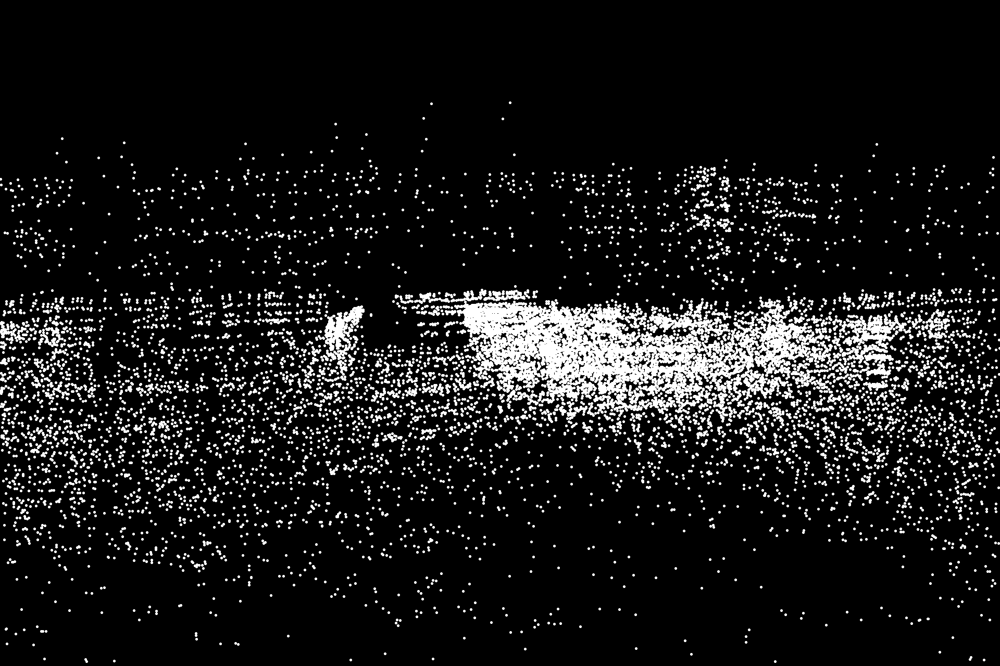

In [27]:
import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = '1b660186-6119-45b5-8d6b-541b9a72c812'

# Create a dictionary to map keypoints to object IDs
keypoint_object_ids = {
    (x, y): object_id
    for x, y in keypoints
}

# Filter the keypoints based on the object ID
filtered_keypoints = [(x, y) for x, y in keypoints if keypoint_object_ids[(x, y)] == object_id]

# Create a blank image with the same size
blank_image = Image.new('RGB', image.size)

# Create a drawing context
draw = ImageDraw.Draw(blank_image)

# Draw keypoints on the blank image
for i in range(len(filtered_keypoints)):
    keypoint_x = int(filtered_keypoints[i][0])
    keypoint_y = int(filtered_keypoints[i][1])

    # Draw the keypoint
    draw.ellipse((keypoint_x - 2, keypoint_y - 2, keypoint_x + 2, keypoint_y + 2), fill='white')

# Overlay the keypoints on the original image
result = Image.alpha_composite(image.convert('RGBA'), blank_image.convert('RGBA'))

# Show the resulting image
result.show()


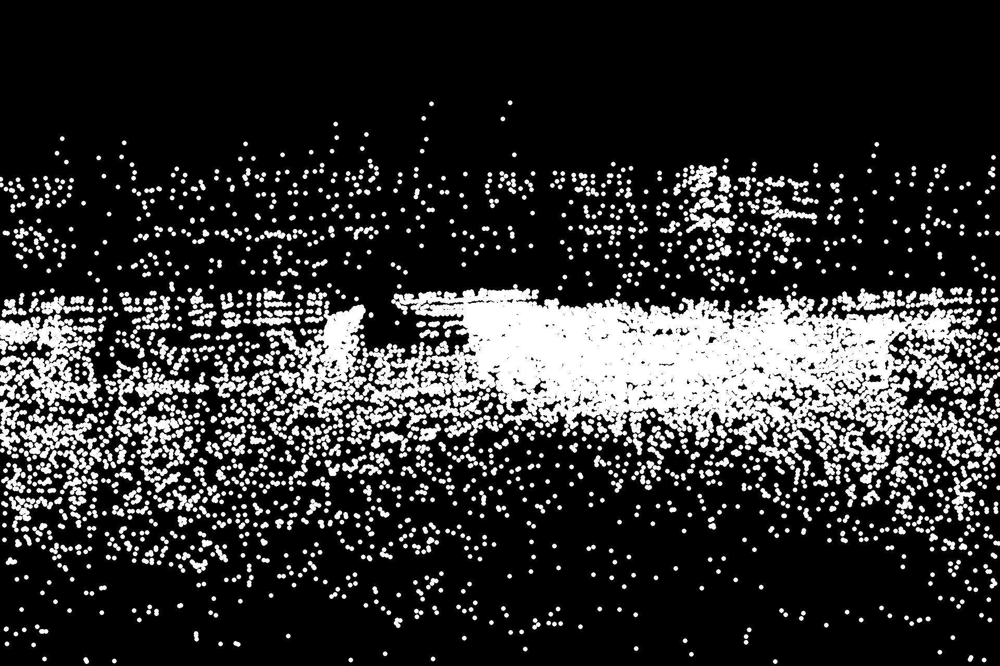

In [57]:
import pandas as pd
from PIL import Image, ImageDraw
from io import BytesIO

# Read the camera image data
image_file = '/content/drive/MyDrive/validation/camera_image/file1.parquet'
image_data = pd.read_parquet(image_file)
image_bytes = image_data['[CameraImageComponent].image'][0]

# Create an image from the bytes data
image = Image.open(BytesIO(image_bytes))

# Load the camera_hkp_data
camera_hkp_file = '/content/drive/MyDrive/validation/camera_hkp/30779396576054160_1880_000_1900_000.parquet'
camera_hkp_data = pd.read_parquet(camera_hkp_file)

# Access the x and y coordinates of the human keypoints
x = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'].explode().values
y = camera_hkp_data['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'].explode().values

# Check if keypoints are present
if len(x) == 0 or len(y) == 0:
    raise ValueError("No human keypoints found in the data")

# Combine x and y coordinates into a list of tuples
keypoints = list(zip(x, y))

# Set the timestamp, camera name, and object ID to mark the keypoints on
timestamp = 1557845072664263
camera_name = 1
object_id = '1b660186-6119-45b5-8d6b-541b9a72c812'


# Filter the keypoints based on the object ID
filtered_keypoints = []
for index, row in camera_hkp_data.iterrows():
    if row['key.camera_object_id'] == object_id:
        keypoint_x = int(row['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.x'][0])
        keypoint_y = int(row['[CameraHumanKeypointsComponent].camera_keypoints[*].keypoint_2d.location_px.y'][0])
        filtered_keypoints.append((keypoint_x, keypoint_y))

# Create a blank image with the same size
blank_image = Image.new('RGB', image.size)

# Create a drawing context
draw = ImageDraw.Draw(blank_image)

# Draw keypoints on the blank image
for i in range(len(keypoints)):
    keypoint_x = int(keypoints[i][0])
    keypoint_y = int(keypoints[i][1])

    # Draw the keypoint
    draw.ellipse((keypoint_x - 4, keypoint_y - 4, keypoint_x + 4, keypoint_y + 4), fill='white')

# Overlay the keypoints on the original image
result = Image.alpha_composite(image.convert('RGBA'), blank_image.convert('RGBA'))

# Show the resulting image
result.show()